## Домашняя работа 3

Задание:

* Загрузить данные и подготовить их
* Построить Кластеризацию методом KNN и агломеративной кластеризацией
* Выбрать количество кластеров при поддержке (VRC, метода локтя и коэффициента контура)
* Проинтерпретировать полученные кластеры  

Данные: https://docs.google.com/document/d/1MQSSgXhB3kZa2e8lXGHlh_6I1NkgsWVfmcvlA9-xK0g/edit#

In [1]:
import pandas as pd
import math 
import numpy as np
from sklearn import cluster
import scipy.cluster.hierarchy as sch
from matplotlib import pyplot as plt
from sklearn.metrics import silhouette_score
from sklearn.metrics.cluster import calinski_harabasz_score
import seaborn as sns

import warnings
warnings.simplefilter('ignore')

In [2]:
CASC_Behaviour=pd.read_csv('D:\Data/CASC_Behaviour (1).csv')
constant=pd.read_csv('D:\Data/CASC_Constant (1).csv')

In [3]:
df = pd.merge(CASC_Behaviour, constant, on='CustomerId')  #объединим данные по признаку 'CustomerId'
df

,CustomerId,FirtsDate,LastDate,LifeSpan,Recency,Num_Checks,Avg_InterpInterv,Avg_BASESUM,Tot_BASESUM,Avg_ORIGSUM,...,Share_BASESUM_MamaRus,Share_BASESUM_PlanCoffee,Share_BASESUM_Costa,Share_BASESUM_Delivery,Share_BASESUM_TakeAway,ActivationDate,Gender,Sex,SubscribedEmail,SubscribedPush
0,2758183,2015-01-28,2015-06-04,127,941,3,63.500000,681.666667,2045.0,681.666667,...,0.0,0.0,0.0,0.0,0.0,2015-01-28,25.0,Female,True,False
1,2751165,2015-04-02,2017-04-29,758,246,3,379.000000,3011.333333,9034.0,3011.333333,...,0.0,0.0,0.0,0.0,0.0,2015-01-21,27.0,Male,True,True
2,2734090,2015-03-08,2017-10-14,951,78,3,475.500000,992.666667,2978.0,992.666667,...,0.0,0.0,0.0,0.0,0.0,2015-01-06,29.0,Female,False,True
3,2736346,2015-01-08,2015-07-05,178,910,4,59.333333,1404.750000,5619.0,1404.750000,...,0.0,0.0,0.0,0.0,0.0,2015-01-08,25.0,NaN,False,False
4,2748651,2015-01-18,2015-03-28,69,1009,4,23.000000,822.250000,3289.0,822.250000,...,0.0,0.0,0.0,0.0,0.0,2015-01-18,26.0,Female,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,2750429,2015-01-20,2015-02-20,31,1045,3,15.500000,1315.666667,3947.0,1206.666667,...,0.0,0.0,0.0,1.0,0.0,2015-01-20,25.0,Male,False,True
9996,2776755,2015-02-14,2015-03-15,29,1022,3,14.500000,833.000000,2499.0,782.000000,...,0.0,0.0,0.0,1.0,0.0,2015-02-14,38.0,NaN,False,True
9997,2745377,2015-01-16,2017-08-14,941,139,20,49.526316,405.550000,8111.0,364.750000,...,0.0,0.0,0.0,0.0,0.0,2015-01-16,28.0,Female,False,True
9998,2812283,2016-03-15,2017-10-16,580,76,11,58.000000,443.636364,4880.0,403.272727,...,0.0,0.0,0.0,0.0,0.0,2015-02-27,39.0,Female,False,False


### EDA  

Уберем данные, не имеющие большого значения. Доли потребления дублируют уже имеющиеся значения, так же например даты и ID не вносят вклад.

In [4]:
df = df.drop(['CustomerId', 'FirtsDate', 'LastDate', 'ActivationDate', 'Share_BASESUM_Lunch', 'Share_BASESUM_FOOD',
              'Share_BASESUM_ALCOHOL', 'Share_BASESUM_NONALCOHOL', 'Share_BASESUM_AmBar', 'Share_BASESUM_MamaRus',
              'Share_BASESUM_PlanCoffee', 'Share_BASESUM_Costa', 'Share_BASESUM_Delivery', 'Share_BASESUM_TakeAway'], axis=1)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 0 to 9999
Data columns (total 27 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   LifeSpan                   10000 non-null  int64  
 1   Recency                    10000 non-null  int64  
 2   Num_Checks                 10000 non-null  int64  
 3   Avg_InterpInterv           10000 non-null  float64
 4   Avg_BASESUM                10000 non-null  float64
 5   Tot_BASESUM                10000 non-null  float64
 6   Avg_ORIGSUM                10000 non-null  float64
 7   Tot_ORIGSUM                10000 non-null  float64
 8   Avg_Discount               10000 non-null  float64
 9   Num_Checks_withAction      10000 non-null  int64  
 10  Share_Checks_withAction    10000 non-null  float64
 11  Avg_NumUniqItems           10000 non-null  float64
 12  Avg_NumItems               10000 non-null  float64
 13  Avg_AvItemPrice            10000 non-null  floa

In [6]:
df = df.dropna() # удаляем пропуски

In [7]:
gender_map = {'Male':0, 'Female':1} # заменим на 0 и 1 значения в графе 'Sex'
df['Sex'] = df['Sex'].map(gender_map)

In [8]:
df['SubscribedEmail'] = df['SubscribedEmail'].astype(int) # заменим на 0 и 1 значения типа bool
df['SubscribedPush'] = df['SubscribedPush'].astype(int)
df

,LifeSpan,Recency,Num_Checks,Avg_InterpInterv,Avg_BASESUM,Tot_BASESUM,Avg_ORIGSUM,Tot_ORIGSUM,Avg_Discount,Num_Checks_withAction,...,Avg_BASESUM_NONALCOHOL,Avg_BASESUM_TransportHabs,Share_BASESUM_ILPatio,Share_BASESUM_PlanSushi,Share_BASESUM_Shikari,Share_BASESUM_TGIFRIDAYS,Gender,Sex,SubscribedEmail,SubscribedPush
0,127,941,3,63.500000,681.666667,2045.0,681.666667,2045.0,0.000000,0,...,26.666667,0.0,0.337408,0.000000,0.0,0.662592,25.0,1,1,0
1,758,246,3,379.000000,3011.333333,9034.0,3011.333333,9034.0,0.000000,0,...,107.333333,0.0,0.607166,0.028654,0.0,0.364180,27.0,0,1,1
2,951,78,3,475.500000,992.666667,2978.0,992.666667,2978.0,0.000000,0,...,144.000000,0.0,0.115850,0.493284,0.0,0.390866,29.0,1,0,1
4,69,1009,4,23.000000,822.250000,3289.0,822.250000,3289.0,0.000000,0,...,174.000000,0.0,0.472501,0.212814,0.0,0.314685,26.0,1,0,0
5,327,744,4,109.000000,1048.750000,4195.0,1048.750000,4195.0,0.000000,0,...,125.000000,0.0,0.094160,0.302026,0.0,0.603814,22.0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9994,55,16,3,27.500000,1839.000000,5517.0,1734.666667,5204.0,0.056734,2,...,0.000000,0.0,1.000000,0.000000,0.0,0.000000,22.0,1,1,0
9995,31,1045,3,15.500000,1315.666667,3947.0,1206.666667,3620.0,0.082848,3,...,0.000000,0.0,1.000000,0.000000,0.0,0.000000,25.0,0,0,1
9997,941,139,20,49.526316,405.550000,8111.0,364.750000,7295.0,0.100604,6,...,0.000000,0.0,1.000000,0.000000,0.0,0.000000,28.0,1,0,1
9998,580,76,11,58.000000,443.636364,4880.0,403.272727,4436.0,0.090984,7,...,0.000000,0.0,1.000000,0.000000,0.0,0.000000,39.0,1,0,0


In [9]:
df.describe()

,LifeSpan,Recency,Num_Checks,Avg_InterpInterv,Avg_BASESUM,Tot_BASESUM,Avg_ORIGSUM,Tot_ORIGSUM,Avg_Discount,Num_Checks_withAction,...,Avg_BASESUM_NONALCOHOL,Avg_BASESUM_TransportHabs,Share_BASESUM_ILPatio,Share_BASESUM_PlanSushi,Share_BASESUM_Shikari,Share_BASESUM_TGIFRIDAYS,Gender,Sex,SubscribedEmail,SubscribedPush
count,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,...,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000,8847.000000
mean,656.458121,320.355940,17.850684,86.460114,1677.536051,25452.077167,1541.424844,23010.859737,0.081534,6.629027,...,272.628939,101.122798,0.489176,0.175600,0.016565,0.248429,32.816661,0.579292,0.570476,0.591048
std,319.817785,307.403888,29.614010,83.571478,839.938517,32436.296864,778.443630,29068.733416,0.046397,10.399397,...,177.087731,293.970735,0.323353,0.226747,0.076620,0.332582,11.362517,0.493701,0.495036,0.491668
min,0.000000,0.000000,3.000000,0.000000,178.597484,660.000000,162.000000,610.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,16.000000,0.000000,0.000000,0.000000
25%,387.000000,52.000000,5.000000,32.000000,1131.433333,7828.500000,1031.373404,7329.000000,0.055835,1.000000,...,149.651709,0.000000,0.203153,0.000000,0.000000,0.000000,26.000000,0.000000,0.000000,0.000000
50%,730.000000,208.000000,9.000000,60.125000,1561.600000,15330.000000,1430.030303,14018.000000,0.087664,3.000000,...,246.750000,0.000000,0.491791,0.078779,0.000000,0.032701,31.000000,1.000000,1.000000,1.000000
75%,953.000000,542.000000,20.000000,110.472222,2056.464286,30739.500000,1895.666667,27577.500000,0.108501,8.000000,...,362.309524,52.911184,0.770089,0.273256,0.000000,0.457258,37.000000,1.000000,1.000000,1.000000
max,1094.000000,1086.000000,888.000000,540.500000,12205.636364,514900.000000,10461.272727,463266.000000,0.353629,204.000000,...,2484.545455,5385.428571,1.000000,1.000000,1.000000,1.000000,218.000000,1.000000,1.000000,1.000000


Уже на этапе анализа описательной статистики видно, что в данных есть аномалии, например в графе Возраст, максимальное значение равно 218. В столбцах Total ### (общая сумма) max значения тоже сильно отличаются от средних значений. Построим boxplot

In [10]:
import plotly.express as px
for x in df.columns:
    fig = px.box(df, y=x, width=400, height=400)
    fig.show()

In [11]:
#Q1 = df['Num_Checks_withAction'].quantile(0.25)
#Q3 = df['Num_Checks_withAction'].quantile(0.75)
#IQR  = Q3 - Q1                            
#lower_l = Q1 - 1.5 * IQR 
#upper_l = Q3 + 1.5 * IQR
#df = df[~((df.loc[:,['Num_Checks_withAction']] < lower_l) | 
#                    (df.loc[:,['Num_Checks_withAction']] > upper_l)).any(axis=1)]
#df.shape

In [12]:
#Q1 = df['Num_Checks'].quantile(0.25) #Num checks
#Q3 = df['Num_Checks'].quantile(0.75)
#IQR  = Q3 - Q1                            
#lower_l = Q1 - 1.5 * IQR 
#upper_l = Q3 + 1.5 * IQR
#df = df[~((df.loc[:,['Num_Checks']] < lower_l) | 
#                    (df.loc[:,['Num_Checks']] > upper_l)).any(axis=1)]
#df.shape

In [13]:
Q1 = df['Gender'].quantile(0.25)  # возраст
Q3 = df['Gender'].quantile(0.75)
IQR  = Q3 - Q1                            
lower_l = Q1 - 1.5 * IQR 
upper_l = Q3 + 1.5 * IQR
df = df[~((df.loc[:,['Gender']] < lower_l) | 
                    (df.loc[:,['Gender']] > upper_l)).any(axis=1)]
df.shape

(8642, 27)

In [14]:
#Q1 = df['Tot_BASESUM'].quantile(0.25)  # Tot_BASESUM
#Q3 = df['Tot_BASESUM'].quantile(0.75)
#IQR  = Q3 - Q1                            
#lower_l = Q1 - 1.5 * IQR 
#upper_l = Q3 + 1.5 * IQR
#df = df[~((df.loc[:,['Tot_BASESUM']] < lower_l) | 
#                    (df.loc[:,['Tot_BASESUM']] > upper_l)).any(axis=1)]
#df.shape

In [15]:
#Q1 = df['Avg_BASESUM'].quantile(0.25)  # Avg_BASESUM
#Q3 = df['Avg_BASESUM'].quantile(0.75)
#IQR  = Q3 - Q1                            
#lower_l = Q1 - 1.5 * IQR 
#upper_l = Q3 + 1.5 * IQR
#df = df[~((df.loc[:,['Avg_BASESUM']] < lower_l) | 
#                    (df.loc[:,['Avg_BASESUM']] > upper_l)).any(axis=1)]
#df.shape

In [16]:
#Q1 = df['Tot_ORIGSUM'].quantile(0.25)  # Tot_ORIGSUM
#Q3 = df['Tot_ORIGSUM'].quantile(0.75)
#IQR  = Q3 - Q1                            
#lower_l = Q1 - 1.5 * IQR 
#upper_l = Q3 + 1.5 * IQR
#df = df[~((df.loc[:,['Tot_ORIGSUM']] < lower_l) | 
#                    (df.loc[:,['Tot_ORIGSUM']] > upper_l)).any(axis=1)]
#df.shape

In [17]:
#Q1 = df['Avg_BASESUM_TransportHabs'].quantile(0.25)  # Avg_BASESUM_TransportHabs
#Q3 = df['Avg_BASESUM_TransportHabs'].quantile(0.75)
#IQR  = Q3 - Q1                            
#lower_l = Q1 - 1.5 * IQR 
#upper_l = Q3 + 1.5 * IQR
#df = df[~((df.loc[:,['Avg_BASESUM_TransportHabs']] < lower_l) | 
#                    (df.loc[:,['Avg_BASESUM_TransportHabs']] > upper_l)).any(axis=1)]
#df.shape

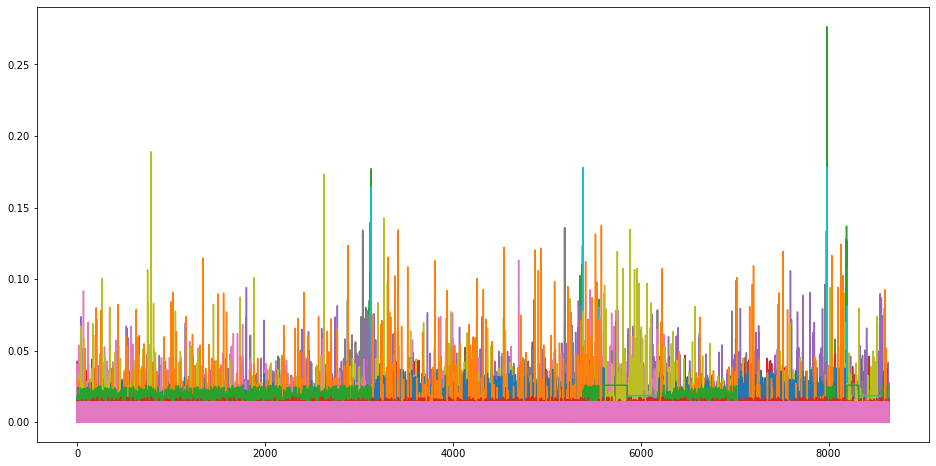

In [18]:
from sklearn.preprocessing import normalize #нормализация данных
#names = {}
norm = normalize(df, axis=0, norm='l2')
df_norm = pd.DataFrame(norm)#, columns = names)
fig, ax = plt.subplots(figsize=(16,8))
plt.plot(df_norm)
#ax.legend(df, loc='upper center', frameon=False)

<Figure size 720x720 with 0 Axes>

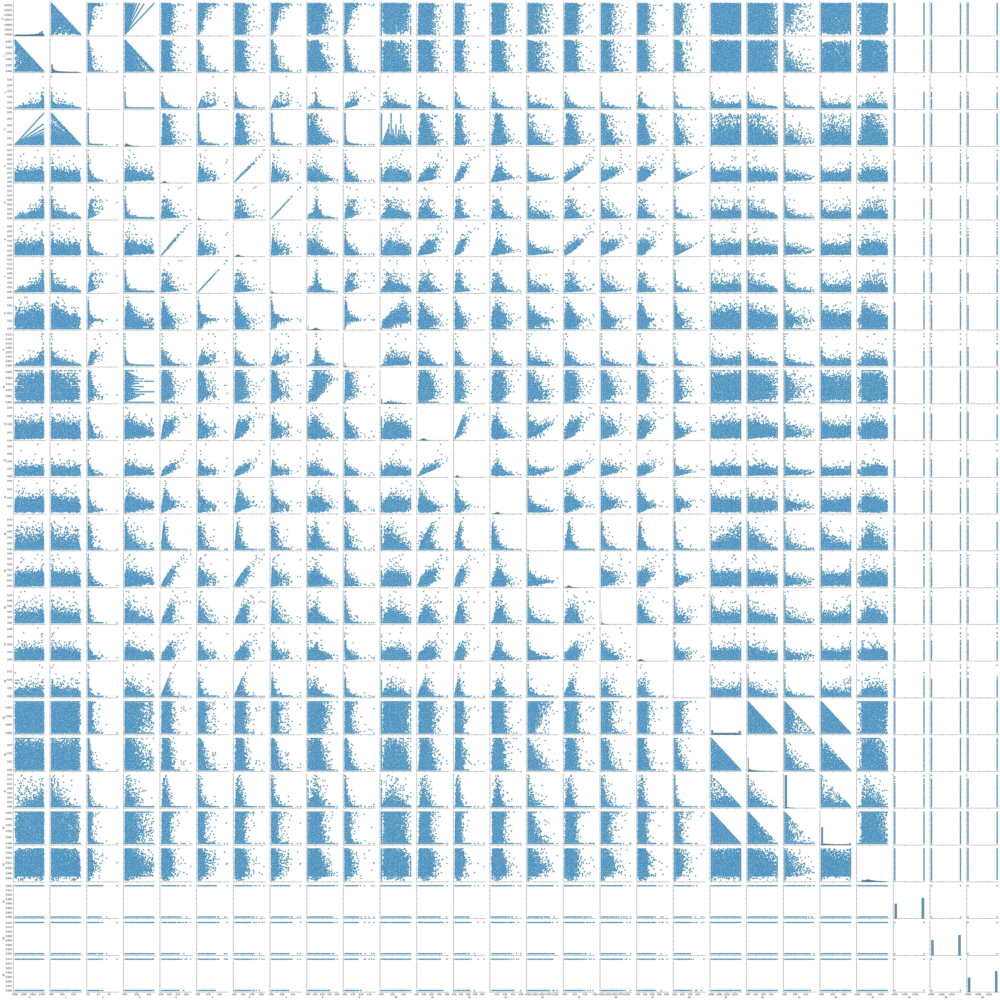

In [19]:
plt.figure(figsize=(10,10))  
sns.pairplot(df_norm, diag_kind = "hist")
plt.show()

### Кластеризация методом KNN и агломеративная кластеризация

In [20]:
def step_kmean(df,class1,class2, n =10, m =0):
    distance_1 = ((df['a']-class1[0])**2 + (df['b']-class1[1])**2 + (df['c']-class1[2])**2)**.5
    distance_2 = ((df['a']-class2[0])**2 + (df['b']-class2[1])**2 + (df['c']-class2[2])**2)**.5
    df['class'] = np.where(distance_2-distance_1>0,'class 1','class 2')
    class1 =df[df['class']=='class 1'].mean()
    class2 =df[df['class']=='class 2'].mean()
    m = m+1
    print(df['class'])
    if m < n: 
        res = step_kmean(df,class1,class2, n = n, m = m)
        df = res[0]
        class1 = res[1]
        class2 = res[2]
        m = res[3]
    return df,class1,class2,m
    

In [21]:
Km = cluster.KMeans(n_clusters=6)
Km.fit_predict(df_norm)

array([0, 3, 0, ..., 5, 0, 5])

In [22]:
AC =cluster.AgglomerativeClustering(n_clusters=6)
AC.fit_predict(df_norm)

array([3, 3, 0, ..., 2, 2, 2], dtype=int64)

In [23]:
Km_ = cluster.KMeans(n_clusters=3)
Km_.fit_predict(df_norm)

array([1, 0, 1, ..., 1, 1, 1])

In [24]:
AC_ =cluster.AgglomerativeClustering(n_clusters=3)
AC_.fit_predict(df_norm)

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

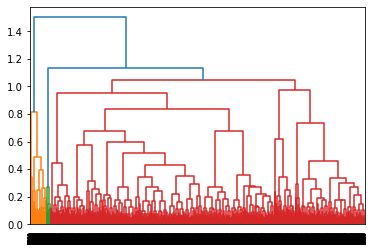

In [42]:
dendrogram = sch.dendrogram(sch.linkage(df_norm, method='ward'))

### Количество кластеров при поддержке (VRC, метода локтя и коэффициента контура)

In [26]:
#qluster number select helper
def quality(df = df_norm, n = 7, method = cluster.KMeans):
    model = method(n_clusters=n)
    predict = model.fit_predict(df)
    Kontur = silhouette_score(df, predict, metric='euclidean')
    VRC = calinski_harabasz_score(df, predict)
    return [Kontur, VRC, n, predict]

In [27]:
all_steps_AG = [quality(n = x, method=cluster.AgglomerativeClustering) for x in range(2,10)] #AGCL

In [28]:
all_steps_KM = [quality(n = x, method=cluster.KMeans) for x in range(2,10)] #KMeans

In [29]:
df_select_helper = pd.DataFrame(all_steps_AG)
df_select_helper.columns =['Kontur','VRC','n_clusters','p']
df_select_helper

,Kontur,VRC,n_clusters,p
0,0.381879,901.931129,2,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,0.387665,751.139590,3,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,0.094169,694.370259,4,"[0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, ..."
3,0.084211,660.280444,5,"[3, 3, 0, 0, 0, 4, 0, 0, 0, 3, 3, 4, 3, 0, 0, ..."
4,0.091000,645.863804,6,"[3, 3, 0, 0, 0, 4, 2, 0, 2, 3, 3, 4, 3, 2, 0, ..."
5,0.066345,621.136329,7,"[1, 1, 3, 3, 2, 4, 6, 2, 6, 1, 1, 4, 1, 6, 2, ..."
6,0.068947,606.006528,8,"[0, 0, 1, 1, 2, 4, 6, 2, 6, 0, 0, 4, 0, 6, 2, ..."
7,0.071741,586.757810,9,"[4, 8, 0, 0, 2, 1, 6, 2, 6, 4, 4, 1, 4, 6, 2, ..."


In [30]:
df_select_helper2 = pd.DataFrame(all_steps_KM)
df_select_helper2.columns =['Kontur','VRC','n_clusters','p']
df_select_helper2

,Kontur,VRC,n_clusters,p
0,0.256818,1107.127523,2,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,0.125463,918.669713,3,"[0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, ..."
2,0.126995,873.413819,4,"[2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, ..."
3,0.108792,825.487796,5,"[0, 2, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 2, ..."
4,0.108587,812.123719,6,"[0, 4, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 0, 4, ..."
5,0.124298,819.834808,7,"[3, 3, 2, 2, 2, 2, 1, 2, 3, 3, 3, 3, 3, 1, 3, ..."
6,0.119598,808.834890,8,"[5, 7, 2, 2, 5, 2, 4, 2, 7, 5, 5, 5, 5, 4, 5, ..."
7,0.118890,798.326856,9,"[4, 5, 1, 0, 4, 0, 3, 0, 5, 4, 4, 4, 4, 3, 4, ..."


In [31]:
xf = []
xf.append(1)

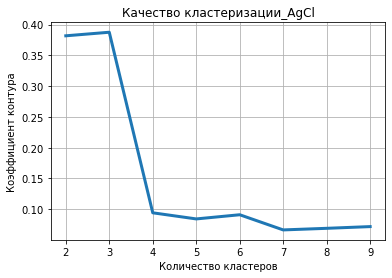

In [32]:
plt.plot(df_select_helper['n_clusters'], df_select_helper['Kontur'], linewidth=3)
plt.grid(True)
plt.xlabel('Количество кластеров')
plt.ylabel('Коэффициент контура')
plt.title('Качество кластеризации_AgCl')
plt.show()

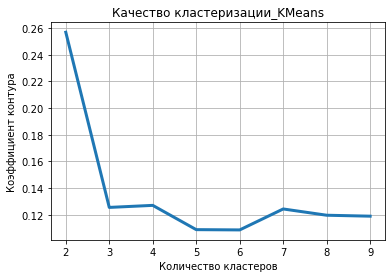

In [33]:
plt.plot(df_select_helper2['n_clusters'], df_select_helper2['Kontur'], linewidth=3)
plt.grid(True)
plt.xlabel('Количество кластеров')
plt.ylabel('Коэффициент контура')
plt.title('Качество кластеризации_KMeans')
plt.show()

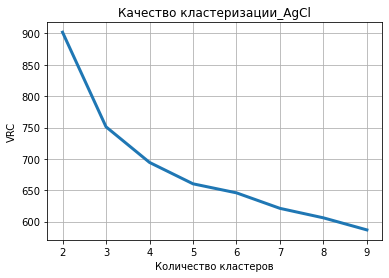

In [34]:
plt.plot(df_select_helper['n_clusters'], df_select_helper['VRC'], linewidth=3)
plt.grid(True)
plt.xlabel('Количество кластеров')
plt.ylabel('VRC')
plt.title('Качество кластеризации_AgCl')
plt.show()

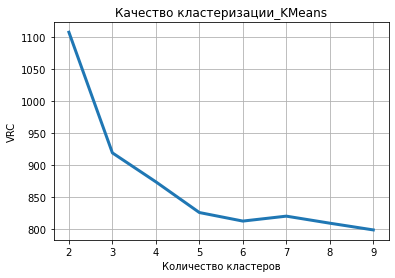

In [35]:
plt.plot(df_select_helper2['n_clusters'], df_select_helper2['VRC'], linewidth=3)
plt.grid(True)
plt.xlabel('Количество кластеров')
plt.ylabel('VRC')
plt.title('Качество кластеризации_KMeans')
plt.show()

In [36]:
quality()

[0.11453692991082966, 817.8503234743506, 7, array([1, 6, 1, ..., 5, 1, 5])]

Text(0.5, 1.0, 'Elbow curve')

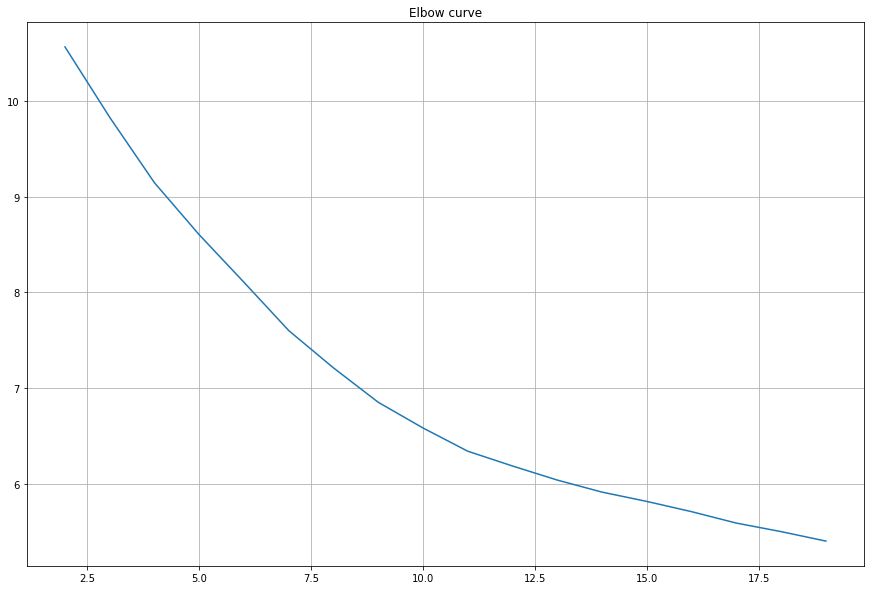

In [37]:
model_kmeans = cluster.KMeans(random_state=17, algorithm='full')  # Elbow curve
X = df_norm
distorsions = []
for k in range(2, 20):
    kmeans = cluster.KMeans(n_clusters=k)
    kmeans.fit(X)
    distorsions.append(kmeans.inertia_)
fig = plt.figure(figsize=(15, 10))
plt.plot(range(2, 20), distorsions)
plt.grid(True)
plt.title('Elbow curve')

In [38]:
import sklearn
sklearn.metrics.cluster.calinski_harabasz_score(df_norm,Km.fit_predict(df_norm))

812.1252834405192

In [39]:
sklearn.metrics.cluster.calinski_harabasz_score(df_norm,AC.fit_predict(df_norm))

645.863804457195

### Критерий качества кластеризации - коэффициент силуэта  

Определяется для каждого метода и состоит из двух баллов:
a : Среднее расстояние между образцом и всеми другими точками того же кластера.
b : Среднее расстояние между образцом и всеми другими точками в следующем ближайшем кластере.
Тогда коэффициент силуэта S для одного образца определяется как: S = (b-a) / max(a,b)

Преимущества:

* оценка ограничена от -1 за неправильную кластеризацию до +1 за высокоплотную кластеризацию. Баллы около нуля указывают на перекрывающиеся кластеры
* оценка выше когда кластеры плотные и хорошо разделенные, что относится к стандартной концепции кластера

In [40]:
from sklearn import metrics
sil12 = metrics.silhouette_score(df_norm, Km.fit_predict(df_norm),metric='euclidean')
sil22 = metrics.silhouette_score(df_norm, AC.fit_predict(df_norm),metric='euclidean')

print('Коээфциент силуэта для 5 кластеров')
print(f'k-means: {sil12:.4f}')
print(f'AgCl: {sil22:.4f}')

Коээфциент силуэта для 5 кластеров
k-means: 0.1001
AgCl: 0.0910


In [41]:
sil11 = metrics.silhouette_score(df_norm, Km_.fit_predict(df_norm),metric='euclidean')
sil21= metrics.silhouette_score(df_norm, AC_.fit_predict(df_norm),metric='euclidean')

print('Коээфциент силуэта для 3 кластеров')
print(f'k-means: {sil11:.4f}')
print(f'AgCl: {sil21:.4f}')

Коээфциент силуэта для 3 кластеров
k-means: 0.1243
AgCl: 0.3877


## Выводы:  

Данные очень плотные, даже просле разделения кластеры перекрывают друг друга. Была проведена кластеризация после удаления выбросов и без. Лучшие результаты показала кластеризация методом AgglomerativeClustering без удаления выбросов с числом кластеров n=3 - коэффициент силуэта 0,4.